# Лабораторная работа №4 Шум

Кобыжев Александр, группа 3530901/80202

### Упражнение 4.1

In [1]:
from __future__ import print_function, division

import thinkdsp
import thinkplot
import thinkstats2

import numpy as np
import pandas as pd

import warnings
warnings.filterwarnings('ignore')

from ipywidgets import interact, interactive, fixed
import ipywidgets as widgets

%matplotlib inline

In [2]:
wave = thinkdsp.read_wave('173920__matias44__murmullo-restaurant.wav')
wave.make_audio()

Я выбрал запись обстановки в ресторане. Выберем короткий отрезок:

In [3]:
segment = wave.segment(start=1.5, duration=1.0)
segment.make_audio()

Составим спектр:

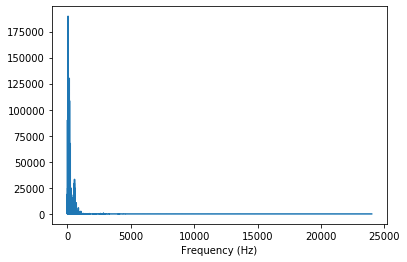

In [4]:
spectrum = segment.make_spectrum()
spectrum.plot_power()
thinkplot.config(xlabel='Frequency (Hz)')

Амплитуда падает с частотой, поэтому это может быть красный или розовый шум. Мы можем проверить это, посмотрев на спектр мощности в логарифмической шкале.

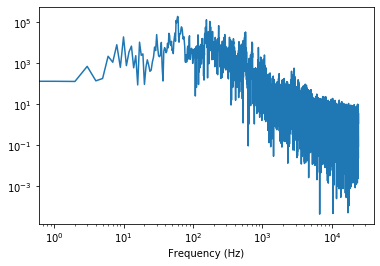

In [5]:
spectrum.plot_power()
thinkplot.config(xlabel='Frequency (Hz)',
                 xscale='log', 
                 yscale='log')

Эта структура с увеличением, а затем и с уменьшением амплитуды кажется обычным явлением для естественных источников шума.
Чтобы увидеть, как спектр меняется с течением времени, я выберу другой сегмент.

In [6]:
segment2 = wave.segment(start=2.5, duration=1.0)
segment2.make_audio()

Теперь рассмотрим два спектра:

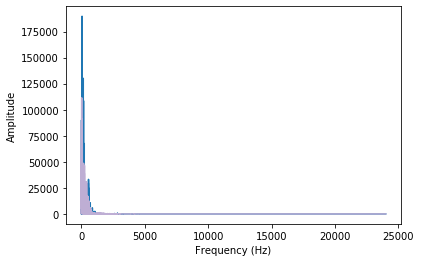

In [7]:
spectrum2 = segment2.make_spectrum()
spectrum.plot_power()
spectrum2.plot_power(color='#beaed4')
thinkplot.config(xlabel='Frequency (Hz)',
                 ylabel='Amplitude')

Теперь рассмотрим график мощности в логарифмическом масштабе.

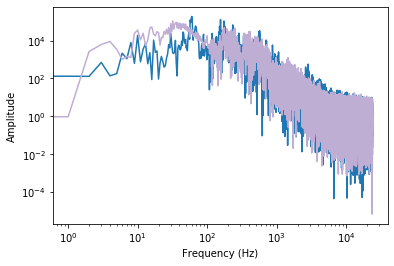

In [8]:
spectrum.plot_power()
spectrum2.plot_power(color='#beaed4')
thinkplot.config(xlabel='Frequency (Hz)',
                 ylabel='Amplitude',
                 xscale='log', 
                 yscale='log')

Таким образом, структура кажется неизменной с течением времени.
Мы также можем посмотреть на спектрограмму:

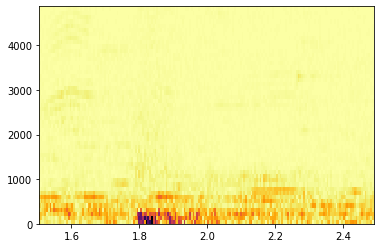

In [9]:
segment.make_spectrogram(512).plot(high=5000)

В этом сегменте общая амплитуда падает, но смесь частот кажется стабильной.

### Упражнение 4.2

bartlett_method создает спектрограмму и извлекает spec_map, который отображает время на объекты Spectrum. Он вычисляет PSD для каждого спектра, складывает их и помещает результаты в объект Spectrum.

Оценивает спектр мощности шумовой волны. wave: Wave seg_length: длина сегмента

In [10]:
def bartlett_method(wave, seg_length=512, win_flag=True):
    # make a spectrogram and extract the spectrums
    spectro = wave.make_spectrogram(seg_length, win_flag)
    spectrums = spectro.spec_map.values()
    
    # extract the power array from each spectrum
    psds = [spectrum.power for spectrum in spectrums]
    
    # compute the root mean power (which is like an amplitude)
    hs = np.sqrt(sum(psds) / len(psds))
    fs = next(iter(spectrums)).fs
    
    # make a Spectrum with the mean amplitudes
    spectrum = thinkdsp.Spectrum(hs, fs, wave.framerate)
    return spectrum

Построим сегменты:

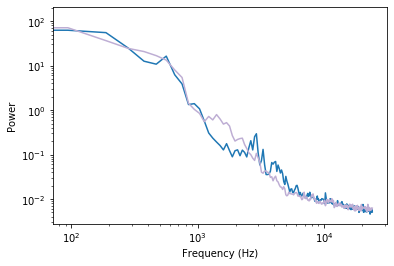

In [11]:
psd = bartlett_method(segment)
psd2 = bartlett_method(segment2)

psd.plot_power()
psd2.plot_power(color='#beaed4')

thinkplot.config(xlabel='Frequency (Hz)', 
                 ylabel='Power', 
                 xscale='log', 
                 yscale='log')

Теперь мы можем более чётко увидеть взаимосвязь между мощностью и частотой. Это не простая линейная зависимость, но она одинакова для разных сегментов, таких как около 1000 Гц, 6000 Гц и выше 10000 Гц.

### Упражнение 4.3

На предложенной веб-странице я скачал данные о ежедневной цене BitCoin в течение года.

In [14]:
data = pd.read_csv('BTC_USD_2020-04-08_2021-04-07-CoinDesk.csv')
data

,Currency,Date,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD)
0,BTC,2020-04-08,7175.667477,7277.704282,7464.732245,7081.639209
1,BTC,2020-04-09,7367.293398,7175.669418,7424.743721,7155.211053
2,BTC,2020-04-10,7321.816614,7366.900961,7399.469133,7125.775519
3,BTC,2020-04-11,6866.398189,7321.815746,7325.324778,6752.593664
4,BTC,2020-04-12,6873.848495,6872.137266,6949.788875,6777.889694
...,...,...,...,...,...,...
360,BTC,2021-04-03,58821.626994,58726.084566,60101.752326,58478.598349
361,BTC,2021-04-04,57517.798773,58958.428985,59713.210136,57185.768006
362,BTC,2021-04-05,58177.402764,57134.860051,58540.984706,56552.222275
363,BTC,2021-04-06,58843.559540,58230.675538,59243.036175,56846.969047


Визуализируем скачанные данные

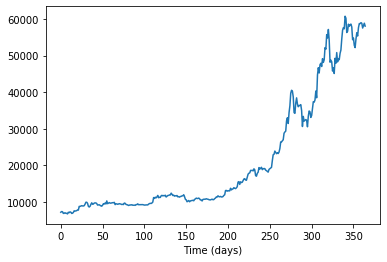

In [15]:
wave = thinkdsp.Wave(data['Closing Price (USD)'], data.index, framerate=1)
wave.plot()
thinkplot.config(xlabel='Time (days)')

Построим спектр искусственно созданного звука, где частотой будет выступать 1/дни.

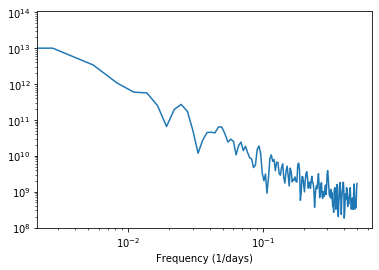

In [16]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
thinkplot.config(xlabel='Frequency (1/days)',
                 xscale='log', yscale='log')

In [17]:
spectrum.estimate_slope()[0]

-1.8216406076974851

Наклон составляет -1,82, что похоже на красный шум (который должен иметь наклон -2).

### Упражнение 4.4

Созданный класс `UncorrelatedPoissonNoise` редставляет некоррелированный пуассоновский шум. Оценивает сигнал в заданное время. ts: массив раз с плавающей запятой возвращает массив волн с плавающей запятой

In [19]:
class UncorrelatedPoissonNoise(thinkdsp.Noise):
    def evaluate(self, ts):
        ys = np.random.poisson(self.amp, len(ts))
        return ys

Рассмотрим как это звучит при низких уровнях «радиации».

In [38]:
amp = 0.001
framerate = 10000
duration = 1

signal = UncorrelatedPoissonNoise(amp=amp)
wave = signal.make_wave(duration=duration, framerate=framerate)
wave.make_audio()

Звук действительно похож на звуки от счётчика Гейгера, будто бы находишься где-то в Припяти. Чтобы убедиться, что все работает, мы сравниваем ожидаемое количество частиц и фактическое количество:

In [39]:
expected = amp * framerate * duration
actual = sum(wave.ys)
print(expected, actual)

10.0 10


Посмотрим на волну:

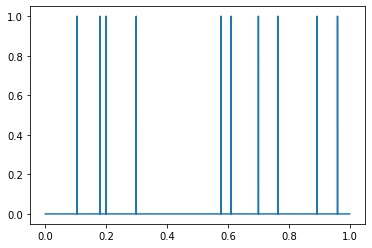

In [40]:
wave.plot()

Рассмотрим спектр мощности в логарифмическом масштабе:

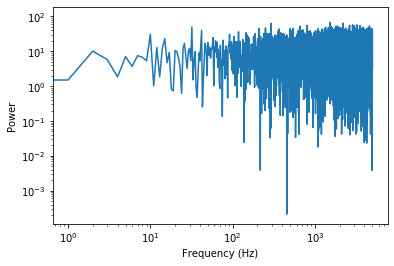

In [41]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
thinkplot.config(xlabel='Frequency (Hz)',
                 ylabel='Power',
                 xscale='log', 
                 yscale='log')

Рассмотрим наклон:

In [42]:
spectrum.estimate_slope().slope

-0.0006437981022653128

Похоже на белый шум, а крутизна близка к 0.

При более высокой скорости поступления это больше похоже на белый шум:

In [43]:
amp = 1
framerate = 10000
duration = 1

signal = UncorrelatedPoissonNoise(amp=amp)
wave = signal.make_wave(duration=duration, framerate=framerate)
wave.make_audio()

Построим график

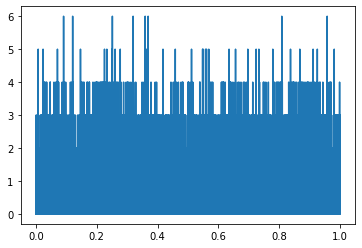

In [44]:
wave.plot()

И спектр сходится на гауссовском шуме.

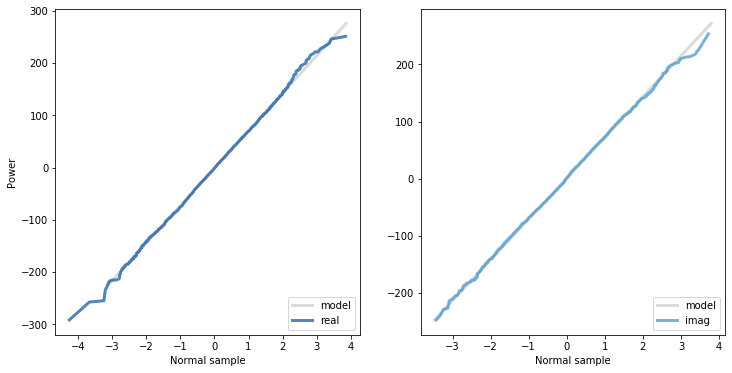

In [45]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0

thinkplot.preplot(2, cols=2)
thinkstats2.NormalProbabilityPlot(spectrum.real, label='real')
thinkplot.config(xlabel='Normal sample',
                 ylabel='Power',
                 legend=True,
                 loc='lower right')

thinkplot.subplot(2)
thinkstats2.NormalProbabilityPlot(spectrum.imag, label='imag')
thinkplot.config(xlabel='Normal sample',
                     loc='lower right')

### Упражнение 4.5

Вот весь процесс в функции:

Создает розовый шум с помощью алгоритма Восса-Маккартни. nrows: количество значений для генерации rcols: количество случайных источников для добавления возвращает: массив NumPy

In [46]:
def voss(nrows, ncols=16):
    array = np.empty((nrows, ncols))
    array.fill(np.nan)
    array[0, :] = np.random.random(ncols)
    array[:, 0] = np.random.random(nrows)
    
    # the total number of changes is nrows
    n = nrows
    cols = np.random.geometric(0.5, n)
    cols[cols >= ncols] = 0
    rows = np.random.randint(nrows, size=n)
    array[rows, cols] = np.random.random(n)

    df = pd.DataFrame(array)
    df.fillna(method='ffill', axis=0, inplace=True)
    total = df.sum(axis=1)

    return total.values

Чтобы проверить это, я сгенерирую 12005 значений:

In [47]:
ys = voss(12005)
ys

array([8.00879581, 8.74600453, 7.81702175, ..., 7.27716771, 7.70656235,
       7.88207295])

И создам из них звук:

In [48]:
wave = thinkdsp.Wave(ys)
wave.unbias()
wave.normalize()

Теперь посмотрим на его визуализацию.

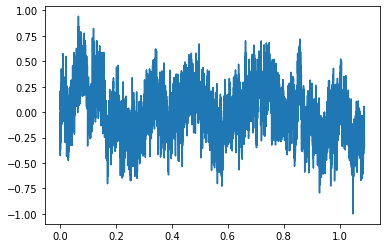

In [49]:
wave.plot()

Как и ожидалось, это больше похоже на случайное блуждание, чем на белый шум, но более случайное, чем на красный шум.

Вот как это звучит:

In [50]:
wave.make_audio()

А вот спектр мощности:

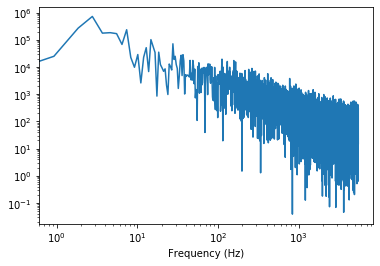

In [51]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0
spectrum.plot_power()
thinkplot.config(xlabel='Frequency (Hz)',
                 xscale='log', 
                 yscale='log')

Посмотрим на наклон:

In [52]:
spectrum.estimate_slope().slope

-1.0129573459835064

Расчетный наклон близок к -1.

Мы можем лучше понять средний спектр мощности, сгенерировав более длинную выборку:

In [53]:
seg_length = 40 * 124
iters = 100
wave = thinkdsp.Wave(voss(seg_length * iters))
len(wave)

496000

И используя метод Барлетта для вычисления среднего.

In [54]:
spectrum = bartlett_method(wave, seg_length=seg_length, win_flag=False)
spectrum.hs[0] = 0
len(spectrum)

2481

Это довольно близко к прямой линии с некоторой кривизной на самых высоких частотах.

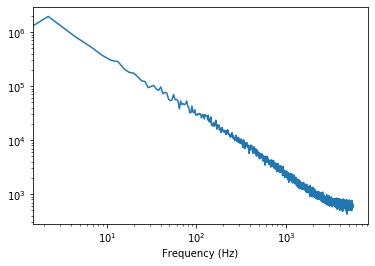

In [55]:
spectrum.plot_power()
thinkplot.config(xlabel='Frequency (Hz)',
                 xscale='log', 
                 yscale='log')

In [56]:
spectrum.estimate_slope().slope

-1.0048368551745679

И наклон близок к -1.